In [2]:
import numpy as np
import scipy as sp
from scipy.spatial import Delaunay
import networkx as nx
import matplotlib.pyplot as plt
import random 
from math import ceil, log10
from sklearn.preprocessing import normalize  

import os
import subprocess

## Generate Data

In [2]:
# for i in range(50): 
#     print('\\node[vertex] (v' + str(i) + ') at (' + str(random.random())  + '*\lw, ' + str(random.random()) +'*\lh) {' + str(i) +'};')  

In [3]:
n = 400
data = np.zeros([n,2])
for i in range(n):
    data[i,0] = random.random()
    data[i,1] = random.random()

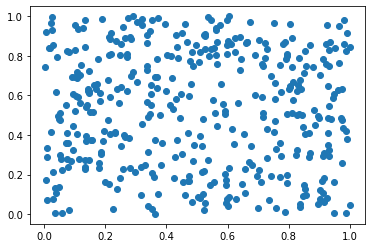

In [17]:
plt.plot(data[:,0], data[:,1], 'o')
plt.show()

In [18]:
np.savetxt('data_large.csv', data)

## Load and Visualize

In [3]:
data = np.loadtxt('data_large.csv')

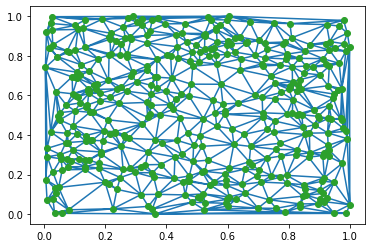

In [4]:
tri = Delaunay(data, qhull_options='QJ')
plt.triplot(data[:,0], data[:,1], tri.simplices.copy())
plt.plot(data[:,0], data[:,1], 'o')

In [5]:
import random

def hops(P, D, u=None):
    if u is None:
        u = 0

    # sample first image of u
    n = len(D.nodes)
    vi = random.randrange(n)
    v = vi

    c, phi, phi_inv, traversallist = find_tree_embeddings(u, v, {u: v}, {v: u}, P, D, list())
    c *= n

    return (c, phi, phi_inv, traversallist)


def find_tree_embeddings(u, v, phi, phi_inv, H, G, traversallist):
    '''u,v must be integer indices that are used to access nodes in H and G.
    phi and phi inverse give the mapping from H to G and from G to H and should
    be initialized to {u: v} and {v: u} if you call it for a initial node pair.
    See the convenience method hops().
    traversallist should be initialized to the empty list and gives you information 
    on the iterations of the method as dicts.'''
    
    U_n = list()
    V_n = list()
    for u_neigh in H.neighbors(u):
        if u_neigh not in phi.keys():
            U_n.append(u_neigh)
    for v_neigh in G.neighbors(v):
        if v_neigh not in phi_inv.keys():
            V_n.append(v_neigh)
    
    # visualization data
    viz = dict()
    viz['u'] = u
    viz['v'] = v
    viz['U_n'] = U_n
    viz['V_n'] = V_n
    viz['ext'] = list()
    traversallist.append(viz)
    
    M, c = uniformRandomMaximumMatching(U_n, V_n, H, G)
    if len(M) == len(U_n):
        # add matching to phi
        for x in M.keys():
            y = M[x]
            phi[x] = y
            phi_inv[y] = x     
            viz['ext'].append((v,y))
            
        viz['phi'] = phi.copy()
        viz['phi_inv'] = phi_inv.copy()
        
        # recurse
        for x in M.keys():
            c_rec, phi, phi_inv, traversallist = find_tree_embeddings(x, M[x], phi, phi_inv, H, G, traversallist)
            c *= c_rec
            if c == 0:
                break
    else:
        c = 0

    return c, phi, phi_inv, traversallist

def n_max_matchings(A, B):
    """
    Compute the number of maximum matchings in a complete bipartite graph on A + B vertices.
    A and B are required to be nonnegative.
    Corner Case: If at least one of the sides has zero vertices, there is one maximal matching: the empty set.
    """
    a = min(A, B)
    b = max(A, B)
    c = 1

    if a != 0:
        for i in range(b - a + 1, b + 1):
            c *= i

    return c


def uniformRandomMaximumMatching(N_u, N_v, H, G):
    """
    Draw a maximum matching from a block disjoint bipartite graph uniformly at random and return it and
    the number of such matchings.

    Which vertex x can be assigned to which vertex y is given by x['predicate'] == y['predicate']

    :param N_u: list of vertices from H that must be assigned
    :param N_v: list of vertices from G that can be assigned to
    :return: M, c : a matching M, given as a map and the number of all maximum matchings c
    """

    hu = dict()
    hv = dict()
    c = 1

    # create blocks of identical symbols
    for x in N_u:
        try:
            hu[H.nodes[x]['predicate']].append(x)
        except KeyError:
            hu[H.nodes[x]['predicate']] = [x]

    for y in N_v:
        try:
            hv[G.nodes[y]['predicate']].append(y)
        except KeyError:
            hv[G.nodes[y]['predicate']] = [y]

    # shuffle target list
    for y in hv.keys():
        random.shuffle(hv[y])

    # compute uniform random maximal matching
    matching = dict()
    for x in hu.keys():
        try:
            for i, j in zip(hu[x], hv[x]):
                matching[i] = j
            c *= n_max_matchings(len(hu[x]), len(hv[x]))
        except KeyError:
            pass
    return matching, c


# taken from sampler_general_ex.py
# assumptions that I am now making:
# - predicate is a categorical label (and used in the same way we use labels)
# - there are no edge labels (they seem to be represented by intermediary 'label vertices' e.g. 'predicate=interaction'
# - if there is a 'valueinpattern' this is an additional restriction and this breaks our assumptions.
#   hence, we will remove this feature from the system for comparison purposes
def predicate_match(x, y):
    if x['predicate'] == y['predicate']:
        if y['valueinpattern'] == 1:
            if 'value' in x.keys() and x['value'] == y['value']:
                return True
            else:
                return False
        else:
            return True
    else:
        return False


# taken from sampler_general_ex.py
def matches(n, D, m, P, matched_list, Plist):
    """
    n - node from dataset graph D to match with node m from pattern P
    matched_list - already matched nodes from D
    Plist - list of node IDs from P, which gives the ordering of finding the pattern
    """
    if predicate_match(D.node[n], P.node[m]):
        test_list = matched_list + [n]
        neighbor_test = True
        for m_neigh in P.neighbors(m):
            index_in_Plist = Plist.index(m_neigh)
            if index_in_Plist < len(test_list):
                image = test_list[index_in_Plist]  # this is m_neigh's corresponding image in D
                if image not in D.neighbors(n):
                    neighbor_test = False
        return neighbor_test
    else:
        return False

In [15]:
def plot_background(filename='largebackground.png'):
    fig = plt.figure(figsize=[16,10])
    ax = fig.add_subplot()

    # create a set for edges that are indexes of the points
    edges = set()
    # for each Delaunay triangle
    for n in range(tri.nsimplex):
        # for each edge of the triangle
        # sort the vertices
        # (sorting avoids duplicated edges being added to the set)
        # and add to the edges set
        edge = sorted([tri.vertices[n,0], tri.vertices[n,1]])
        edges.add((edge[0], edge[1]))
        edge = sorted([tri.vertices[n,0], tri.vertices[n,2]])
        edges.add((edge[0], edge[1]))
        edge = sorted([tri.vertices[n,1], tri.vertices[n,2]])
        edges.add((edge[0], edge[1]))


    # make a graph based on the Delaunay triangulation edges
    graph = nx.Graph()
    graph.add_nodes_from(range(data.shape[0]))
    graph.add_edges_from(edges)
    nx.set_node_attributes(graph, name='predicate', values='x')

    # plot graph
    pointIDXY = dict(zip(range(len(data)), data))
    nx.draw_networkx_edges(graph, pointIDXY, edge_color='gray', ax=ax)
    nx.draw_networkx_nodes(graph, pointIDXY, ax=ax, node_size=20, node_color='gray')
    plt.axis('off')
    plt.savefig(filename)
    plt.show()
    plt.close(fig)
    
    return graph, pointIDXY

In [7]:
def enrich_viz(viz):
    viz[0]['old_phi_inv'] = dict()
    viz[0]['old_edges'] = list()
    viz[0]['old_edges_pattern'] = list()
    for i in range(1,len(viz)):
        viz[i]['old_phi_inv'] = viz[i-1]['phi_inv']
        viz[i]['old_edges'] = viz[i-1]['old_edges'] + viz[i-1]['ext']
        viz[i]['old_edges_pattern'] = viz[i-1]['old_edges_pattern'] + [(viz[i]['phi_inv'][e[0]], viz[i]['phi_inv'][e[1]]) for e in viz[i-1]['ext']]

In [8]:
def get_format_positions(viz):
    # compute right number of trailing zeros for file names
    format_positions = ceil(log10(3 * len(viz)))
    return format_positions

def wrap_embedding(res, show=False, pic_id=0, data_path='./', pic_prefix='bb', format_positions=3):
    i = len(res[3]) - 1
    show_embedding(graph, pointIDXY, star, starIDXY, 
                   i=i, 
                   viz=res[3], 
                   format_positions=format_positions, 
                   show=show, 
                   pic_id=pic_id,
                   data_path=data_path,
                   pic_prefix=pic_prefix)

def show_embedding(graph, pointIDXY, pattern, patternIDXY, i, viz, 
                   format_positions, show=False, pic_id=None, data_path='./', pic_prefix='bb', current_estimate=None):
    # Selected matching
    fig = plt.figure(figsize=[16,10])
    ax = fig.add_subplot()   
    
    
    # pattern
    nx.draw_networkx_edges(pattern, pos=patternIDXY,
                           edge_color='gray', ax=ax)
    nx.draw_networkx_edges(pattern, patternIDXY, 
                           edgelist=viz[i]['old_edges_pattern'], 
                           edge_color='blue', ax=ax)
     
    nx.draw_networkx_nodes(pattern, patternIDXY, 
                           node_color='gray', ax=ax)
    nx.draw_networkx_nodes(pattern, patternIDXY, 
                           nodelist=viz[i]['old_phi_inv'].values(), node_color='blue',
                           ax=ax)
    nx.draw_networkx_nodes(pattern, patternIDXY, 
                           nodelist=viz[i]['phi_inv'].values(), node_color='blue',
                           ax=ax)
    
    # graph
    nx.draw_networkx_edges(graph, pointIDXY, 
                           edgelist=[e for e in graph.edges], 
                           edge_color='gray', ax=ax)
    nx.draw_networkx_edges(graph, pointIDXY, 
                           edgelist=viz[i]['old_edges'], 
                           edge_color='blue', ax=ax)

    nx.draw_networkx_nodes(graph, pointIDXY, 
                           node_color='gray', node_size=20, 
                           ax=ax)
    nx.draw_networkx_nodes(graph, pointIDXY, 
                           nodelist=viz[i]['old_phi_inv'].keys(), 
                           node_color='blue', node_size=20, 
                           ax=ax)
    nx.draw_networkx_nodes(graph, pointIDXY, 
                           nodelist=viz[i]['phi_inv'].keys(), 
                           node_color='blue', node_size=20, 
                           cax=ax)
    
    if current_estimate is None:
        plt.text(0.01, 0.5, s=f'Pattern Count: {pic_id + 1}', fontsize=20, fontfamily='Purisa',
             horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
    else:
        plt.text(0.01, 0.5, s=f'Estimate: {current_estimate}', fontsize=20, fontfamily='Purisa',
             horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
    
    plt.axis('off')

    if pic_id is None:
        plt.savefig(os.path.join(data_path, f'{i:0{format_positions}d}_3.png'))
    else:
        plt.savefig(os.path.join(data_path, f'{pic_prefix}{pic_id:0{format_positions}d}.png'))
    if show:
        plt.show()
    plt.close(fig)
    
# wrap_embedding(embeddings[3], show=True, pic_id=3, pic_prefix=pic_prefix, format_positions=fp)

NameError: name 'embeddings' is not defined

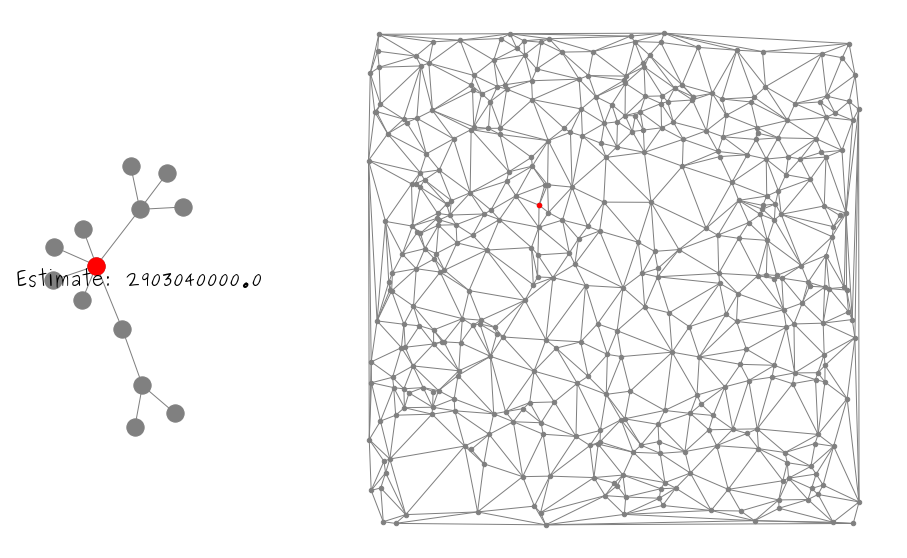

In [47]:
def wrap_estimate(res, show=False, pic_id=0, estimate=None, data_path='./', pic_prefix='bb', format_positions=3):
    i = len(res[3]) - 1
    if res[0] > 0:
        show_embedding(graph, pointIDXY, star, starIDXY, 
                       i=i, 
                       viz=res[3], 
                       format_positions=format_positions, 
                       show=show, 
                       pic_id=pic_id,
                       data_path=data_path,
                       pic_prefix=pic_prefix, current_estimate=estimate)
    else:
        show_fail(graph, pointIDXY, star, starIDXY, 
                       i=i, 
                       viz=res[3], 
                       format_positions=format_positions, 
                       show=show, 
                       pic_id=pic_id,
                       data_path=data_path,
                       pic_prefix=pic_prefix, current_estimate=estimate)

def show_fail(graph, pointIDXY, pattern, patternIDXY, i, viz, 
                   format_positions, show=False, pic_id=None, data_path='./', pic_prefix='bb', current_estimate=None):
    
    # Selected matching
    fig = plt.figure(figsize=[16,10])
    ax = fig.add_subplot()     
    
    # pattern
    nx.draw_networkx_edges(pattern, pos=patternIDXY,
                           edge_color='gray', ax=ax)
#     nx.draw_networkx_edges(pattern, patternIDXY, 
#                            edgelist=viz[i]['old_edges_pattern'], 
#                            edge_color='blue', ax=ax)
     
    nx.draw_networkx_nodes(pattern, patternIDXY, 
                           node_color='gray', ax=ax)
    nx.draw_networkx_nodes(pattern, patternIDXY, 
                           nodelist=viz[i]['old_phi_inv'].values(), node_color='red',
                           ax=ax)
    nx.draw_networkx_nodes(pattern, patternIDXY, 
                           nodelist=[viz[i]['u']], node_color='red',
                           ax=ax)
#     nx.draw_networkx_nodes(pattern, patternIDXY, 
#                            nodelist=viz[i]['phi_inv'].values(), node_color='blue',
#                            ax=ax)
    
    # graph
    nx.draw_networkx_edges(graph, pointIDXY, 
                           edgelist=[e for e in graph.edges], 
                           edge_color='gray', ax=ax)
    nx.draw_networkx_edges(graph, pointIDXY, 
                           edgelist=viz[i]['old_edges'], 
                           edge_color='red', ax=ax)

    nx.draw_networkx_nodes(graph, pointIDXY, 
                           node_color='gray', node_size=20, 
                           ax=ax)
    nx.draw_networkx_nodes(graph, pointIDXY, 
                           nodelist=viz[i]['old_phi_inv'].keys(), 
                           node_color='red', node_size=20, 
                           ax=ax)
    # hotfix to have at least the central nodes red
    nx.draw_networkx_nodes(graph, pointIDXY, 
                           nodelist=[viz[i]['v']],
                           node_color='red', node_size=20, 
                           ax=ax)
#     nx.draw_networkx_nodes(graph, pointIDXY, 
#                            nodelist=viz[i]['phi_inv'].keys(), 
#                            node_color='blue', node_size=20, 
#                            cax=ax)
    
    if current_estimate is None:
        plt.text(0.01, 0.5, s=f'Pattern Count: {pic_id + 1}', fontsize=20, fontfamily='Purisa',
             horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
    else:
        plt.text(0.01, 0.5, s=f'Estimate: {current_estimate}', fontsize=20, fontfamily='Purisa',
             horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
    
    plt.axis('off')

    if pic_id is None:
        plt.savefig(os.path.join(data_path, f'{i:0{format_positions}d}_3.png'))
    else:
        plt.savefig(os.path.join(data_path, f'{pic_prefix}{pic_id:0{format_positions}d}.png'))
    if show:
        plt.show()
    plt.close(fig)
  

i=1 
wrap_estimate(trials[i], show=True, pic_id=i, pic_prefix=pic_prefix, format_positions=fp, estimate=estimates[i])

In [31]:
def filter_same_center_embeddings(embeddings):
    '''Actually, what we would need to do to do it properly, would be to remove only such
    embeddings that have identical phi's. But for visualization purposes, it seems better 
    to remove those embeddings that have identical root nodes, for now'''
    
    # assuming that center node of pattern is vertex with id 0, v is its image in G
    v = lambda res: res[1][0]
    
    # store only one embedding per image of u
    unique_centers = {v(res): res for res in embeddings}
    return [unique_centers[k] for k in unique_centers]
    

In [32]:
def make_video(outfile, format_positions, fps=1, pic_prefix='bb'):
    stuff = subprocess.run(['ffmpeg', 
                            '-r', f'{fps}', 
                            '-f', 'image2', 
                            '-s', '1152x720', 
                            '-i', f'{pic_prefix}%0{format_positions}d.png', 
                            '-vcodec', 'libx264', 
                            '-crf', '25', 
                            '-pix_fmt', 'yuv420p', 
                            outfile])
    print(stuff)

## Plot Series of Embeddings

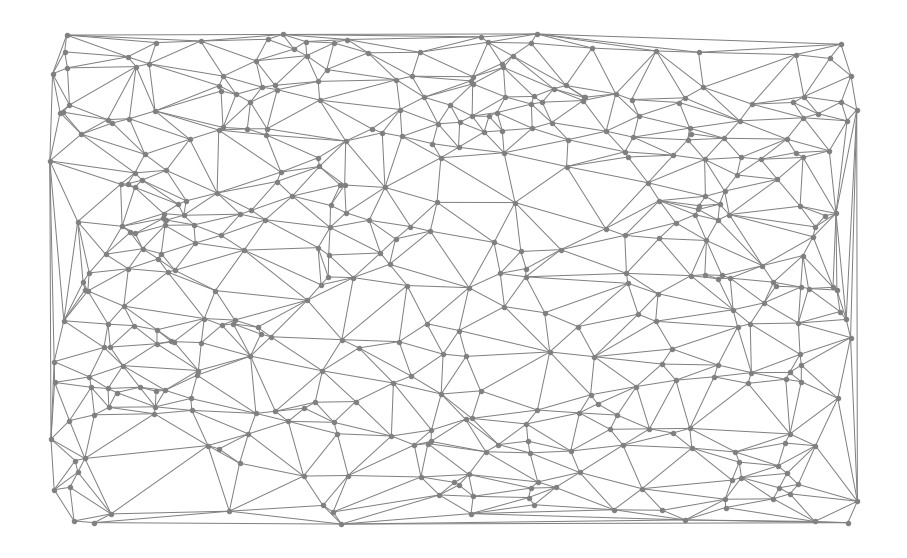

In [16]:
graph, pointIDXY = plot_background()

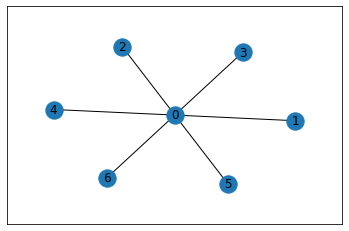

In [12]:
# create pattern graph
star = nx.star_graph(6)
nx.set_node_attributes(star, name='predicate', values='x')
starIDXY = nx.spring_layout(star, scale=0.1, center=(-0.5, 0.75))
nx.draw_networkx(star, pos=starIDXY)

### Plot naive counting

In [80]:
pic_prefix='bb'

# compute lots of embeddings
trials = [hops(star, graph) for i in range(100)]

# select sucessful tries
embeddings = [e for e in filter(lambda t: t[0]>0, trials)]

# TODO: filter out duplicates.
embeddings = filter_same_center_embeddings(embeddings)

# add additional visualization info
for res in embeddings:
    enrich_viz(res[3])
    
# compute format positions
fp = get_format_positions(embeddings)

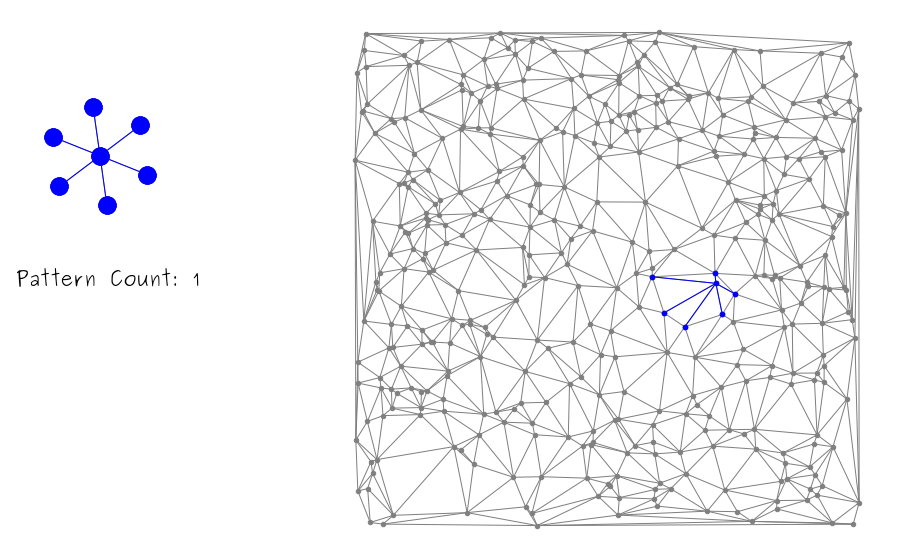

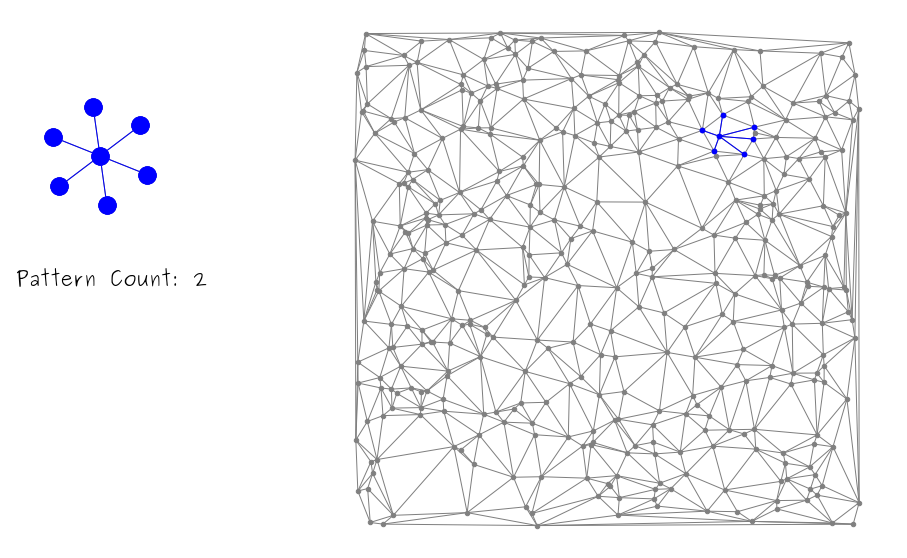

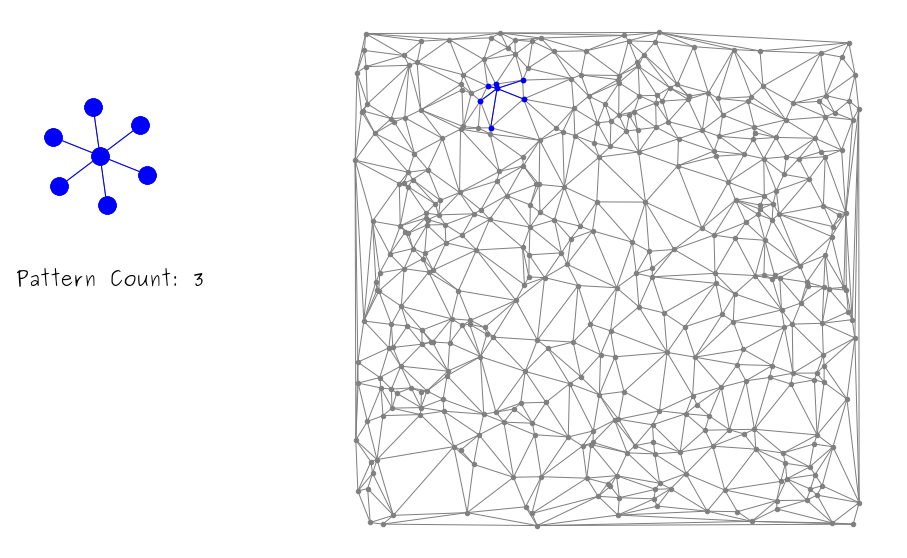

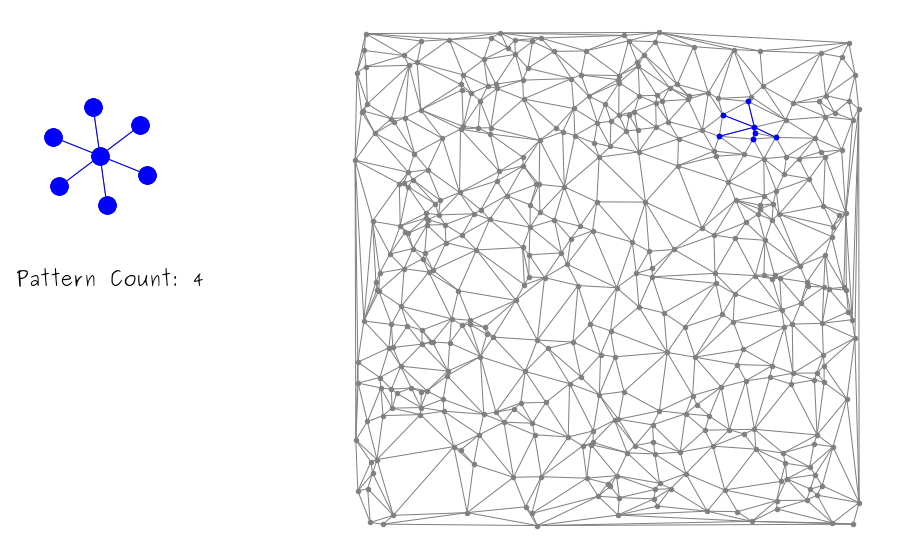

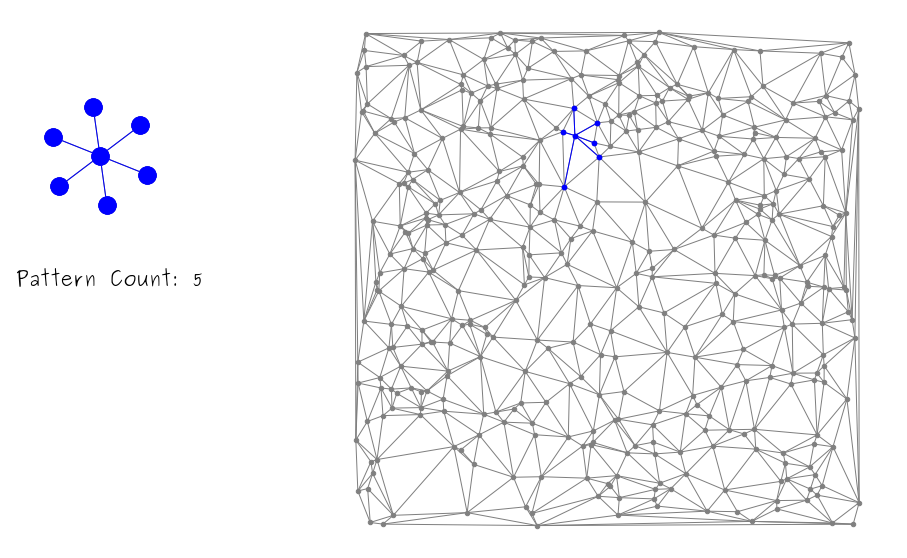

...

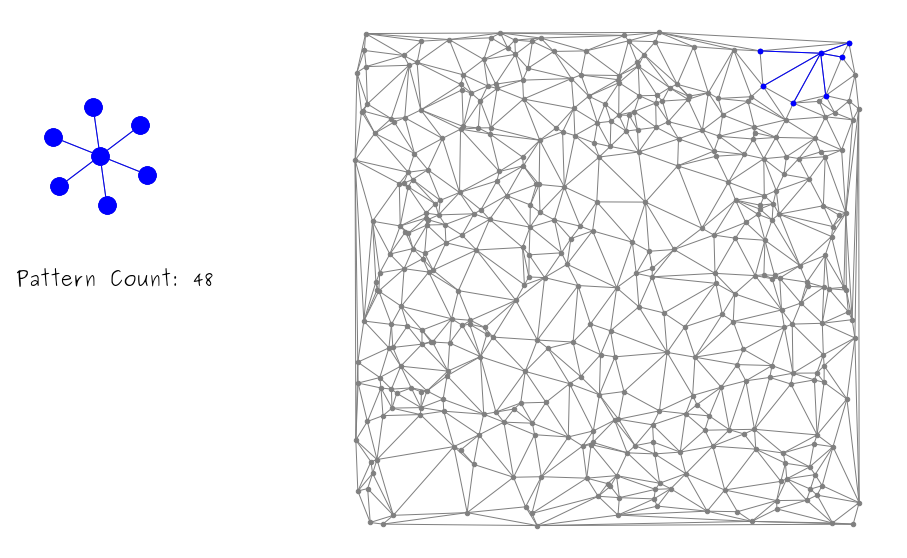

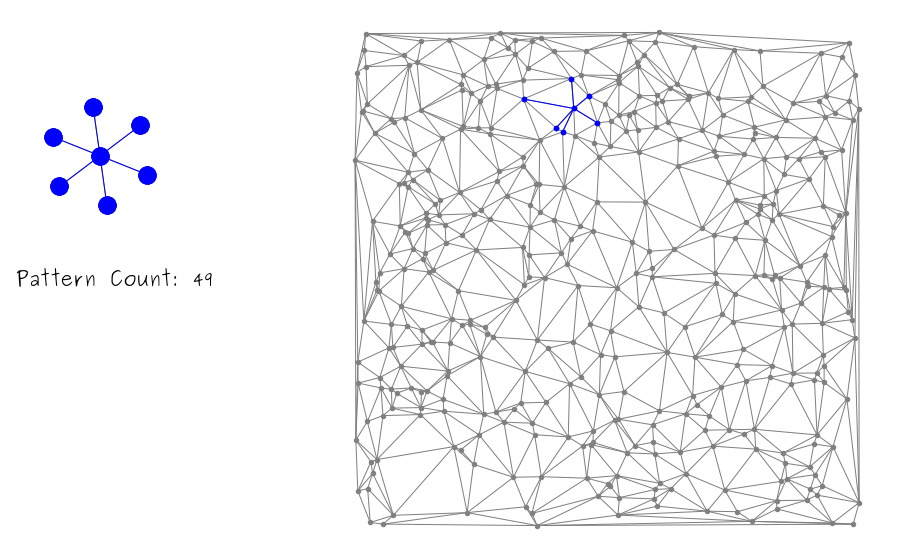

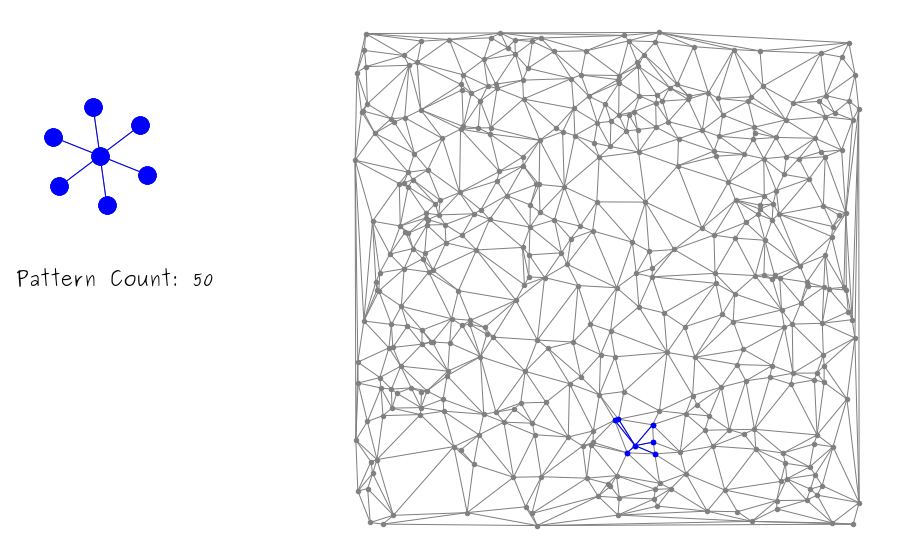

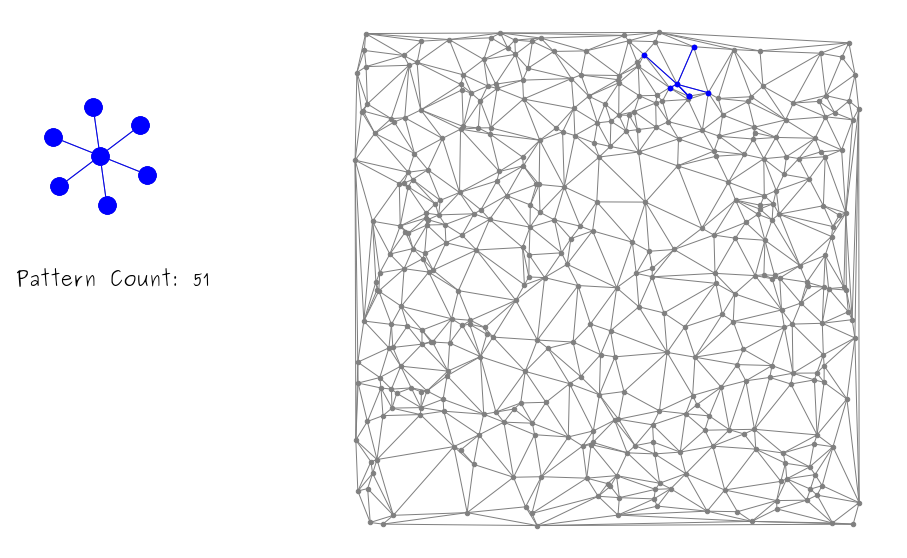

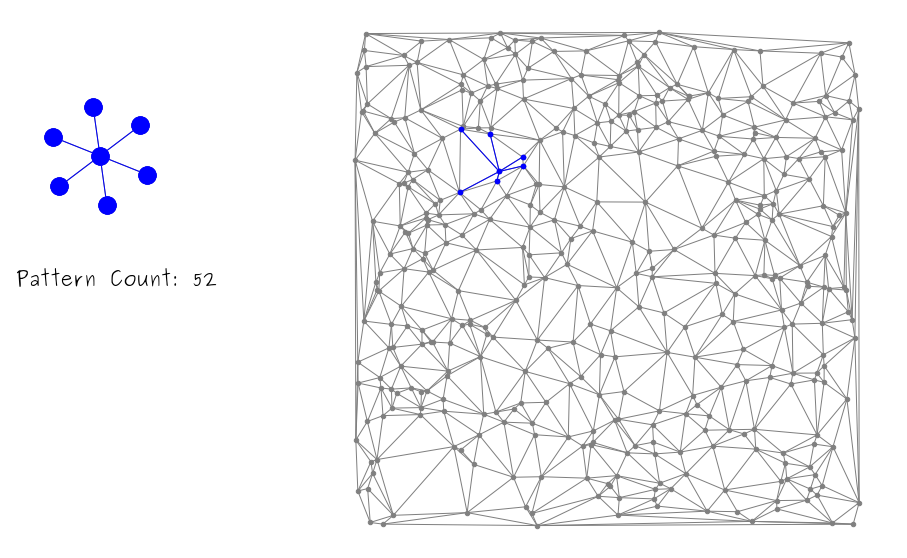

In [90]:
# render stuff
for i, e in enumerate(embeddings):
    wrap_embedding(embeddings[i], show=True, pic_id=i, pic_prefix=pic_prefix, format_positions=fp)

In [93]:
make_video(outfile='video_multiple_patterns_with_counts.mp4', format_positions=fp, pic_prefix=pic_prefix)

CompletedProcess(args=['ffmpeg', '-r', '1', '-f', 'image2', '-s', '1152x720', '-i', 'bb%03d.png', '-vcodec', 'libx264', '-crf', '25', '-pix_fmt', 'yuv420p', 'video_multiple_patterns_with_counts.mp4'], returncode=0)


In [94]:
make_video(outfile='video_multiple_patterns_with_counts_2fps.mp4', 
           format_positions=fp, pic_prefix=pic_prefix, fps=2)

CompletedProcess(args=['ffmpeg', '-r', '2', '-f', 'image2', '-s', '1152x720', '-i', 'bb%03d.png', '-vcodec', 'libx264', '-crf', '25', '-pix_fmt', 'yuv420p', 'video_multiple_patterns_with_counts_2fps.mp4'], returncode=0)


### Plot Estimates

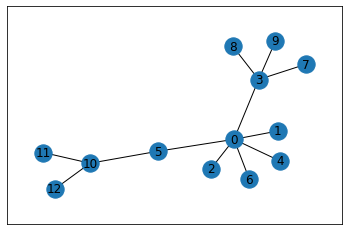

In [50]:
# create pattern graph
star = nx.star_graph(6)
star.add_edges_from([(3,7), (3,8), (3,9), (5,10), (10,11), (10,12)])
nx.set_node_attributes(star, name='predicate', values='x')
starIDXY = nx.spring_layout(star, scale=0.2, center=(-0.5, 0.75))
nx.draw_networkx(star, pos=starIDXY)

In [27]:
pic_prefix='ee'

# compute lots of embeddings
trials = [hops(star, graph) for i in range(100)]

# compute estimates # shitty quadratic implementation
estimates = [sum(t[0] for t in trials[:i+1]) / (i+1) for i in range(len(trials))]
print([t[0] for t in trials])
print(estimates)

# add additional visualization info
for res in trials:
    try:
        enrich_viz(res[3])
    except Exception:
        pass
    
# compute format positions
fp = get_format_positions(trials)

[5806080000, 0, 0, 2903040000, 0, 0, 0, 0, 0, 725760000, 2903040000, 10368000, 580608000, 725760000, 0, 0, 0, 4354560000, 0, 3483648000, 155520000, 0, 0, 0, 829440000, 0, 0, 1088640000, 0, 0, 0, 0, 0, 1741824000, 0, 0, 0, 0, 7257600000, 17418240000, 1209600000, 0, 0, 331776000, 967680000, 4838400000, 14515200000, 82944000, 0, 580608000, 0, 0, 1935360000, 82944000, 0, 0, 0, 28740096000, 0, 0, 0, 0, 0, 0, 4354560000, 0, 207360000, 34560000, 483840000, 0, 0, 0, 11612160000, 0, 7257600000, 0, 2419200000, 0, 0, 0, 725760000, 0, 0, 1161216000, 580608000, 0, 0, 0, 0, 622080000, 207360000, 0, 290304000, 11612160000, 20736000, 0, 0, 18144000000, 20736000, 23224320000]
[5806080000.0, 2903040000.0, 1935360000.0, 2177280000.0, 1741824000.0, 1451520000.0, 1244160000.0, 1088640000.0, 967680000.0, 943488000.0, 1121629090.909091, 1029024000.0, 994530461.5384616, 975332571.4285715, 910310400.0, 853416000.0, 803215058.8235294, 1000512000.0, 947853473.6842105, 1074643200.0, 1030875428.5714285, 984017454.

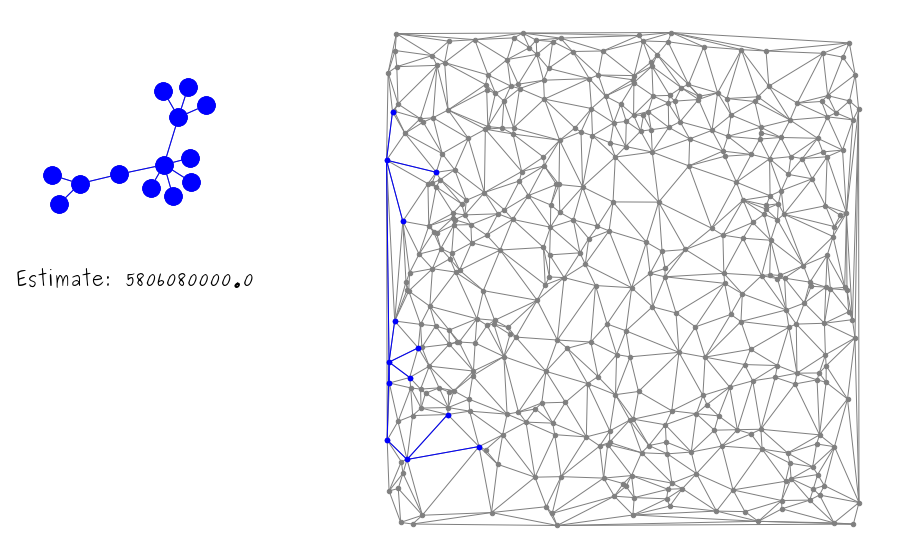

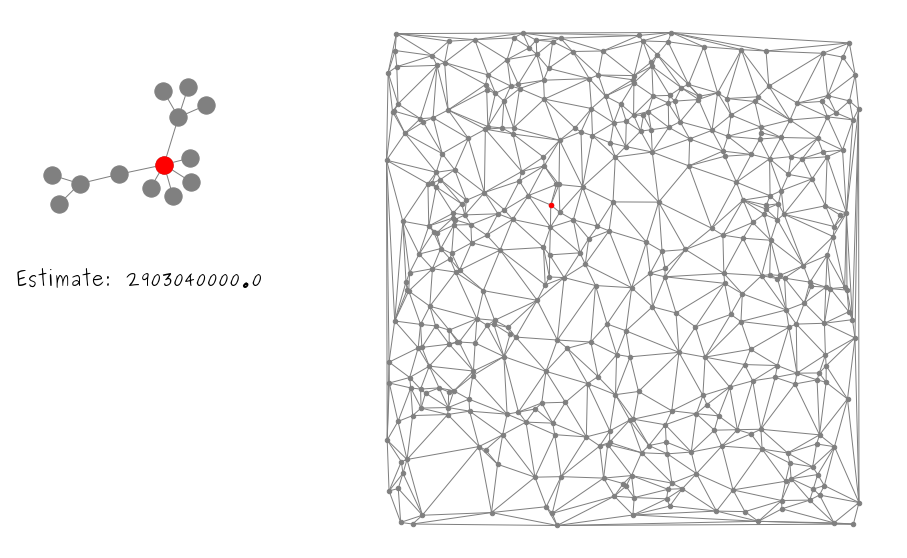

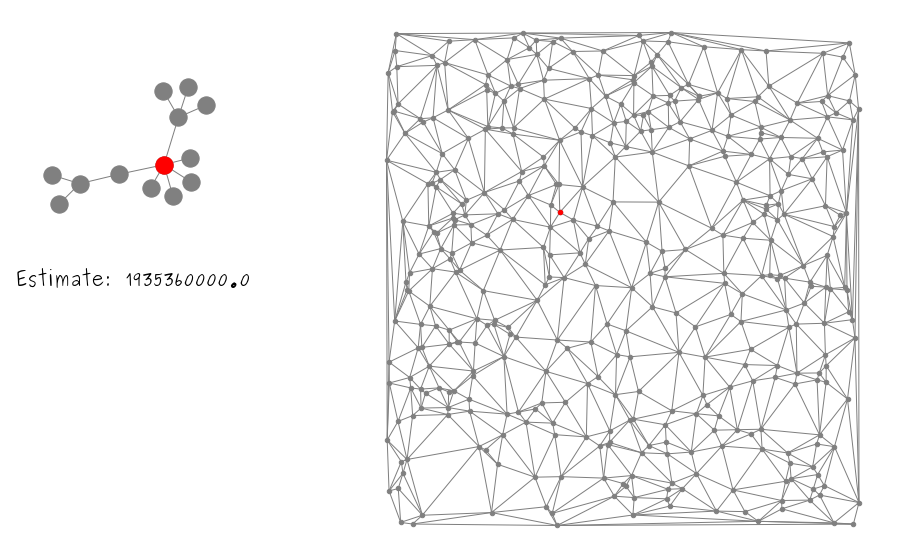

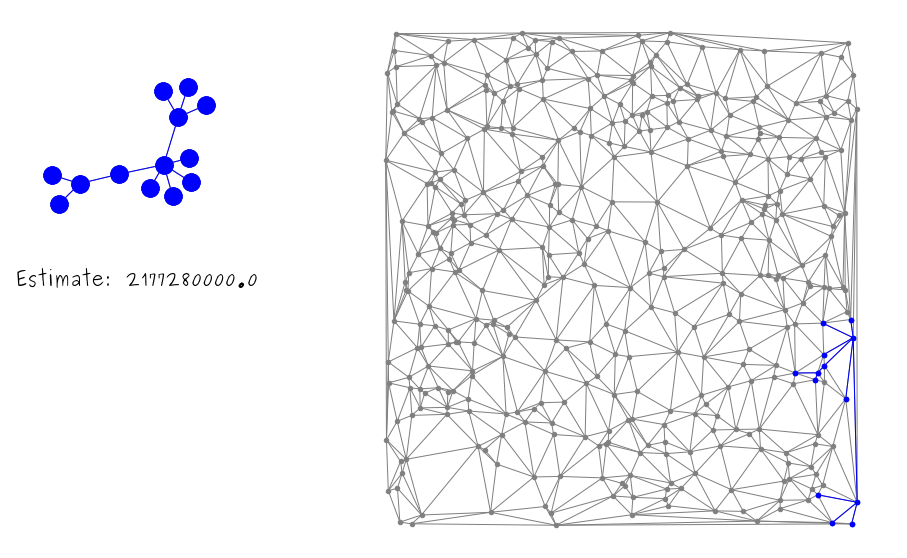

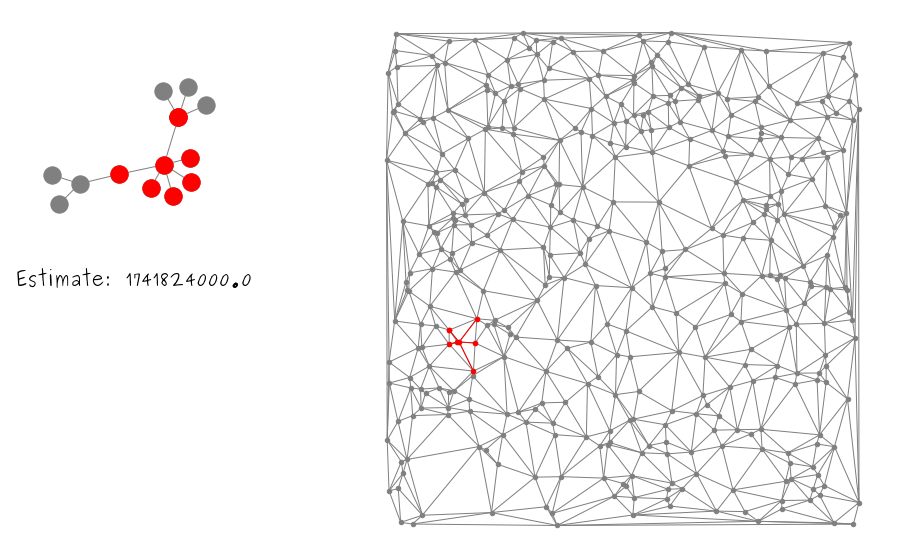

...

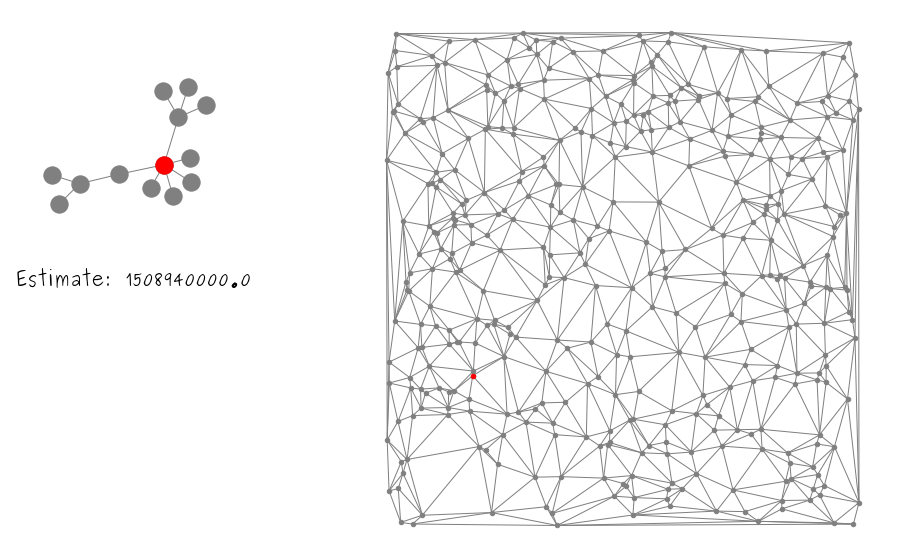

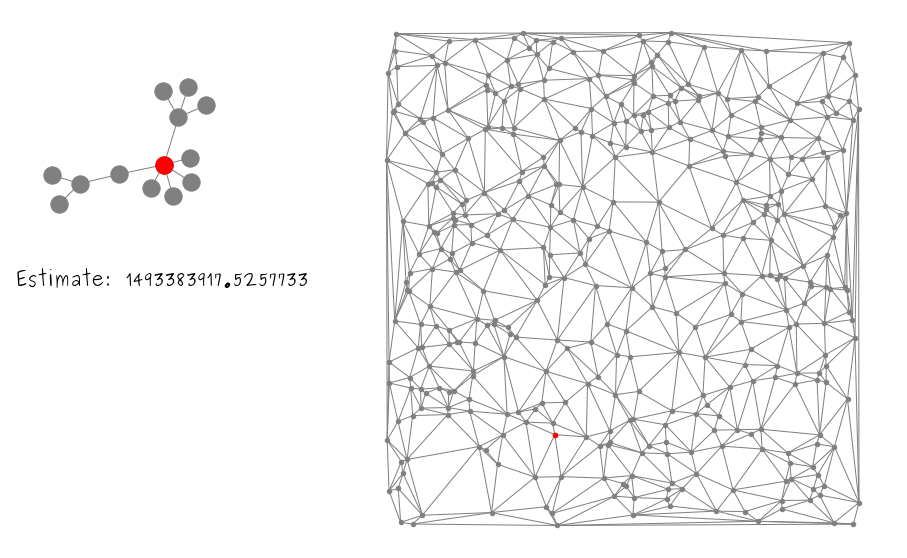

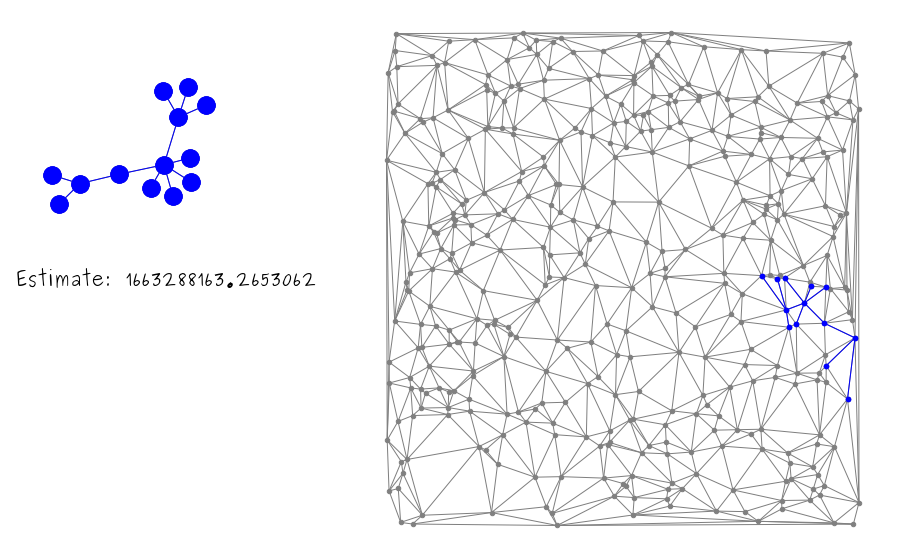

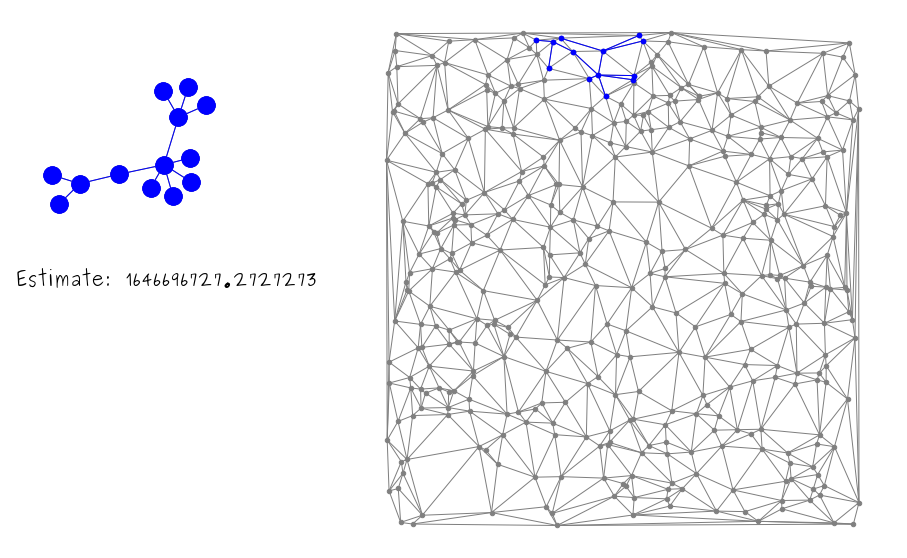

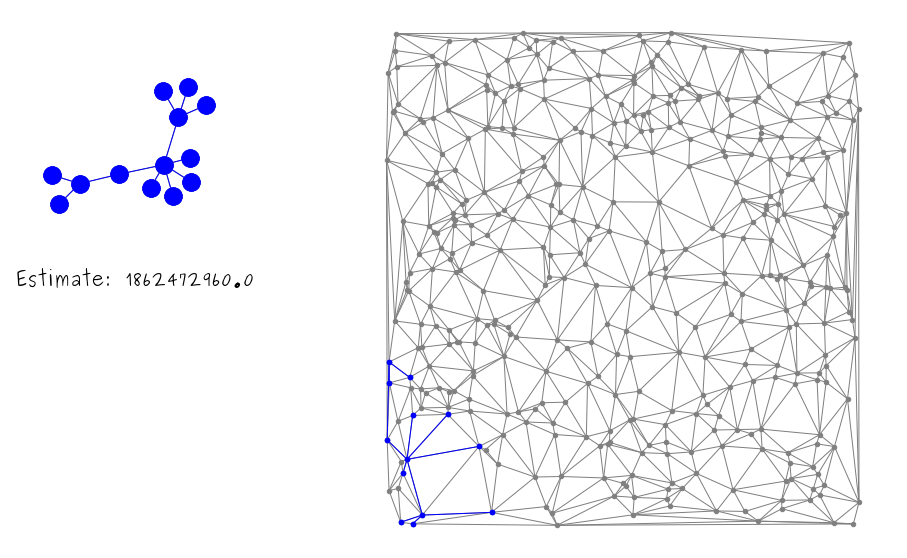

In [51]:
# render stuff
for i, e in enumerate(trials):
    wrap_estimate(trials[i], show=True, pic_id=i, pic_prefix=pic_prefix, format_positions=fp, estimate=estimates[i])

In [52]:
make_video(outfile='video_estimation_process_2fps.mp4', 
           format_positions=fp, pic_prefix=pic_prefix, fps=2)

CompletedProcess(args=['ffmpeg', '-r', '2', '-f', 'image2', '-s', '1152x720', '-i', 'ee%03d.png', '-vcodec', 'libx264', '-crf', '25', '-pix_fmt', 'yuv420p', 'video_estimation_process_2fps.mp4'], returncode=0)


In [55]:
# compute good estimate of the number of embeddings
def get_good_estimate(N):
    cumulative_estimates = sum(hops(star, graph)[0] for i in range(N))
    print(cumulative_estimates // N)
    print(cumulative_estimates / N)

In [63]:
%timeit get_good_estimate(2000)

2636762112
2636762112.0
2849211072
2849211072.0
2079490752
2079490752.0
3217548096
3217548096.0
2365683840
2365683840.0
3248057664
3248057664.0
2279328768
2279328768.0
2278851840
2278851840.0
403 ms ± 16.3 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [57]:
get_good_estimate(100000)

2616533003
2616533003.52


In [58]:
get_good_estimate(100000)

2711780225
2711780225.28


In [59]:
get_good_estimate(1000000)

2584449047
2584449047.808
